In [1]:
import numpy as np
import pandas as pd
import plotly.express as px

In [2]:
bike_df = pd.read_parquet('Data/bike_data_10-19.parquet')
bike_df.head()

,ride_id,Bike_number,Duration,Start_date,End_date,Start_station,Start_station_number,Start_capacity,End_station,End_station_number,End_capacity,start_lat,start_lon,end_lat,end_lon,Member_type
0,0,W00742,1012,2010-09-20 11:27:04,2010-09-20 11:43:56,M St & New Jersey Ave SE,31208,17,4th & M St SW,31108,23,38.876304,-77.003702,38.876708,-77.017900,Member
1,1,W00032,61,2010-09-20 11:41:22,2010-09-20 11:42:23,1st & N St SE,31209,39,1st & N St SE,31209,39,38.874106,-77.005799,38.874106,-77.005799,Member
2,2,W00993,2690,2010-09-20 12:05:37,2010-09-20 12:50:27,5th & K St NW,31600,19,19th St & Pennsylvania Ave NW,31100,15,38.903048,-77.019025,38.900303,-77.042899,Member
3,3,W00344,1406,2010-09-20 12:06:05,2010-09-20 12:29:32,5th & K St NW,31600,19,Park Rd & Holmead Pl NW,31602,35,38.903048,-77.019025,38.930809,-77.031499,Member
4,4,W00883,1413,2010-09-20 12:10:43,2010-09-20 12:34:17,19th St & Pennsylvania Ave NW,31100,15,15th & P St NW,31201,19,38.900303,-77.042899,38.909810,-77.034430,Member


### In diesem Beispiel werden wir verschiedene Modelle fur eine Station trainieren und für diese eine Station Vorhersagen machen.

- Features: Zeitreihe mit Feiertagen und/ oder Wetterdaten
- Vorhergsage: Auslastung -> Anzahl Rentals pro Stunde oder pro Tag
- Traindaten: 2010-2017
- Testdaten: 2018, 2019
- Validierungsdaten: 2020-2022

In [3]:
union_station = bike_df[
    (bike_df['Start_station'] == 'Columbus Circle / Union Station') |
    (bike_df['End_station'] == 'Columbus Circle / Union Station')
].copy(deep=True)

In [4]:
del bike_df

In [5]:
union_station.head()

,ride_id,Bike_number,Duration,Start_date,End_date,Start_station,Start_station_number,Start_capacity,End_station,End_station_number,End_capacity,start_lat,start_lon,end_lat,end_lon,Member_type
30311,30311,W00813,828,2010-10-26 11:47:25,2010-10-26 12:01:14,Columbus Circle / Union Station,31623,55,13th St & New York Ave NW,31227,23,38.896969,-77.004936,38.900290,-77.029826,Casual
30329,30329,W00563,120,2010-10-26 12:16:44,2010-10-26 12:18:44,Columbus Circle / Union Station,31623,55,3rd & H St NE,31616,19,38.896969,-77.004936,38.900419,-77.001951,Member
30446,30446,W00892,126,2010-10-26 14:06:09,2010-10-26 14:08:15,3rd & H St NE,31616,19,Columbus Circle / Union Station,31623,55,38.900419,-77.001951,38.896969,-77.004936,Member
30459,30459,W00727,627,2010-10-26 14:20:33,2010-10-26 14:31:01,Convention Center / 7th & M St NW,31223,23,Columbus Circle / Union Station,31623,55,38.905741,-77.022277,38.896969,-77.004936,Member
30541,30541,W00636,491,2010-10-26 15:30:02,2010-10-26 15:38:14,Columbus Circle / Union Station,31623,55,13th & H St NE,31611,27,38.896969,-77.004936,38.900437,-76.988255,Member


In [6]:
# Dauer der Fahrt in Minuten
union_station['minutes'] = union_station['Duration']/60

In [7]:
union_station[
    (union_station['Start_station'] == 'Columbus Circle / Union Station') &
    (union_station['End_station'] == 'Columbus Circle / Union Station') &
    (union_station['minutes'] < 5)
]

,ride_id,Bike_number,Duration,Start_date,End_date,Start_station,Start_station_number,Start_capacity,End_station,End_station_number,End_capacity,start_lat,start_lon,end_lat,end_lon,Member_type,minutes
36784,36784,W00581,200,2010-10-30 14:18:15,2010-10-30 14:21:36,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,3.333333
36805,36805,W00446,167,2010-10-30 14:22:54,2010-10-30 14:25:41,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,2.783333
55263,55263,W01015,77,2010-11-10 20:12:12,2010-11-10 20:13:29,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,1.283333
69893,69893,W00968,289,2010-11-18 19:14:16,2010-11-18 19:19:05,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,4.816667
74361,74361,W00814,122,2010-11-20 21:30:28,2010-11-20 21:32:31,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,2.033333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26136619,26136619,W24679,170,2019-12-22 17:19:52,2019-12-22 17:22:43,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,2.833333
26159125,26159125,W23708,82,2019-12-28 15:12:10,2019-12-28 15:13:33,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,1.366667
26159132,26159132,W24003,61,2019-12-28 15:12:26,2019-12-28 15:13:27,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Member,1.016667
26161264,26161264,W01090,232,2019-12-28 19:39:41,2019-12-28 19:43:33,Columbus Circle / Union Station,31623,55,Columbus Circle / Union Station,31623,55,38.896969,-77.004936,38.896969,-77.004936,Casual,3.866667


In [8]:
# Wenn die Fahrt an der Station endet
incomings = union_station[
    (union_station['End_station'] == 'Columbus Circle / Union Station') &
    (union_station['minutes'] >= 5)
]
# Wenn die Fahrt von der Station beginnt
outgoings = union_station[
    (union_station['Start_station'] == 'Columbus Circle / Union Station') &
    (union_station['minutes'] >= 5)
]

In [9]:
incomings.dtypes

ride_id                          int64
Bike_number                   category
Duration                         int64
Start_date              datetime64[ns]
End_date                datetime64[ns]
Start_station                   object
Start_station_number             int64
Start_capacity                   int64
End_station                     object
End_station_number               int64
End_capacity                     int64
start_lat                      float64
start_lon                      float64
end_lat                        float64
end_lon                        float64
Member_type                   category
minutes                        float64
dtype: object

In [10]:
incomings = incomings.groupby(pd.Grouper(key='Start_date', freq='h')).agg(
    {
        'ride_id': 'count',
        'start_lat': 'median',
        'start_lon': 'median',
        'end_lat': 'median',
        'end_lon': 'median'
    }
)
outgoings = outgoings.groupby(pd.Grouper(key='Start_date', freq='h')).agg(
    {
        'ride_id': 'count',
        'start_lat': 'median',
        'start_lon': 'median',
        'end_lat': 'median',
        'end_lon': 'median'
    }
)

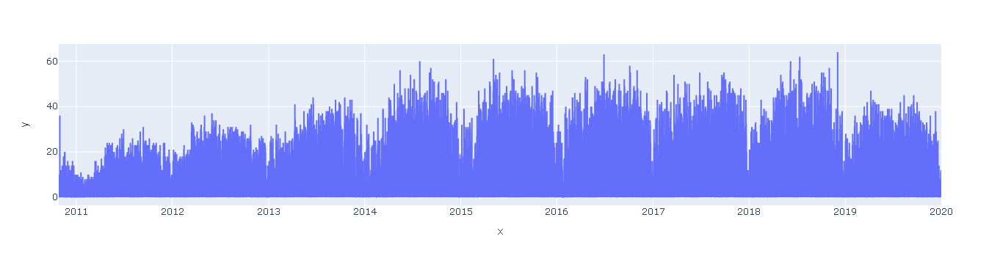

In [11]:
px.line(x=outgoings.index, y=outgoings.ride_id)

In [30]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import statsmodels.api as sm
import matplotlib
import pmdarima as pm

In [31]:
from statsmodels.tsa.stattools import adfuller

In [34]:
def adf_test(timeseries):
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=[
        'Test Statistic','p-value','#Lags Used','Number of Observations Used'
    ])
    for key,value in dftest[4].items():
       df.output['Critical Value (%s)'%key] = value
    print(dfoutput)

In [11]:
outgoings.rename(columns = {'ride_id': 'rentals_in_hour'}, inplace=True)

In [12]:
outgoings.fillna(method='ffill', inplace=True)

In [14]:
outgoings

,rentals_in_hour,start_lat,start_lon,end_lat,end_lon
Start_date,,,,,
2010-10-26 11:00:00,2,38.896969,-77.004936,38.900290,-77.029826
2010-10-26 12:00:00,0,38.896969,-77.004936,38.900290,-77.029826
2010-10-26 13:00:00,0,38.896969,-77.004936,38.900290,-77.029826
2010-10-26 14:00:00,0,38.896969,-77.004936,38.900290,-77.029826
2010-10-26 15:00:00,4,38.896969,-77.004936,38.909106,-77.010174
...,...,...,...,...,...
2019-12-31 18:00:00,1,38.896969,-77.004936,38.907914,-76.997074
2019-12-31 19:00:00,1,38.896969,-77.004936,38.890465,-76.988360
2019-12-31 20:00:00,1,38.896969,-77.004936,38.889961,-77.000348


### Test ob die Zeitreihe Stationär ist oder nicht

In [39]:
output = adf_test(outgoings['rentals_in_hour'])
output

Results of Dickey-Fuller Test:
Test Statistic                   -26.438592
p-value                            0.000000
#Lags Used                        64.000000
Number of Observations Used    80419.000000
Critical Value (1%)               -3.430431
Critical Value (5%)               -2.861576
Critical Value (10%)              -2.566789
dtype: float64


In [49]:
output_2 =  adf_test(outgoings.loc[:'2014', 'renrtals_in_hour'])
output_2

Results of Dickey-Fuller Test:
Test Statistic                -1.479504e+01
p-value                        2.142027e-27
#Lags Used                     5.200000e+01
Number of Observations Used    3.660800e+04
Critical Value (1%)           -3.430529e+00
Critical Value (5%)           -2.861619e+00
Critical Value (10%)          -2.566812e+00
dtype: float64


### Komponente der Zeitreihe (Trend, Saisonal)

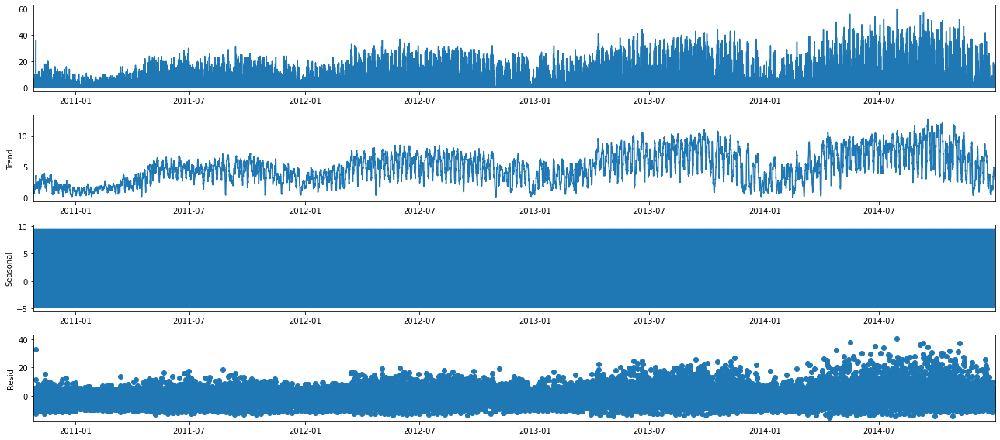

In [51]:
from pylab import rcParams
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(outgoings[:'2014'], model='additive')
fig = decomposition.plot()
plt.show()

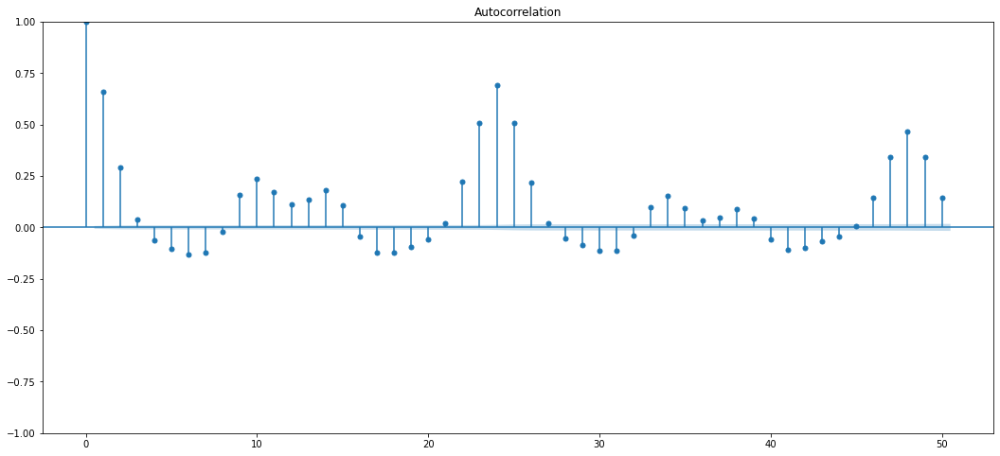

C:\Users\Admin\anaconda3\envs\streamlitApp\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



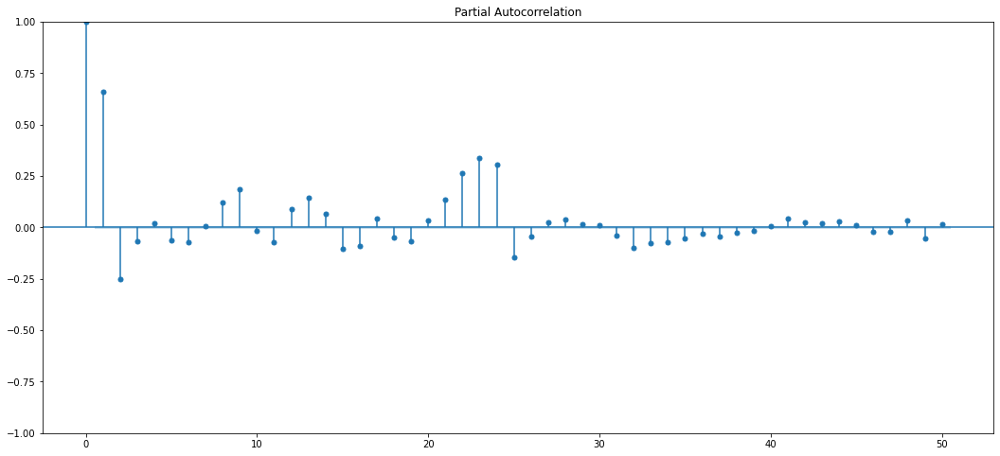

In [52]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
plot_acf(outgoings)
matplotlib.pyplot.show()
plot_pacf(outgoings)
matplotlib.pyplot.show()

In [13]:
train_data = outgoings[:'2017'].copy()
train_data

,ride_id
Start_date,
2010-10-26 11:00:00,2
2010-10-26 12:00:00,0
2010-10-26 13:00:00,0
2010-10-26 14:00:00,0
2010-10-26 15:00:00,4
...,...
2017-12-31 19:00:00,0
2017-12-31 20:00:00,0
2017-12-31 21:00:00,0


In [14]:
# outgoings = outgoings.reset_index()
# outgoings.columns = ['ds', 'y']
# outgoings.set_index('ds')
test_data = outgoings['2018':].copy()
test_data

,ride_id
Start_date,
2018-01-01 00:00:00,0
2018-01-01 01:00:00,1
2018-01-01 02:00:00,0
2018-01-01 03:00:00,0
2018-01-01 04:00:00,0
...,...
2019-12-31 18:00:00,1
2019-12-31 19:00:00,1
2019-12-31 20:00:00,1


In [15]:
test_data = test_data[['rentals_in_hour']]
test_data = test_data.reset_index()
test_data.columns = ['ds', 'y']
train_data = train_data.reset_index()
train_data = train_data[['rentals_in_hour']]
train_data.columns = ['ds', 'y']

In [16]:
from prophet import Prophet

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [17]:
m = Prophet(changepoint_prior_scale=0.12)
m.add_country_holidays(country_name='US')
m.fit(train_data)

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [18]:
test_data.shape

(17519, 2)

In [19]:
periods = test_data.shape[0]

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



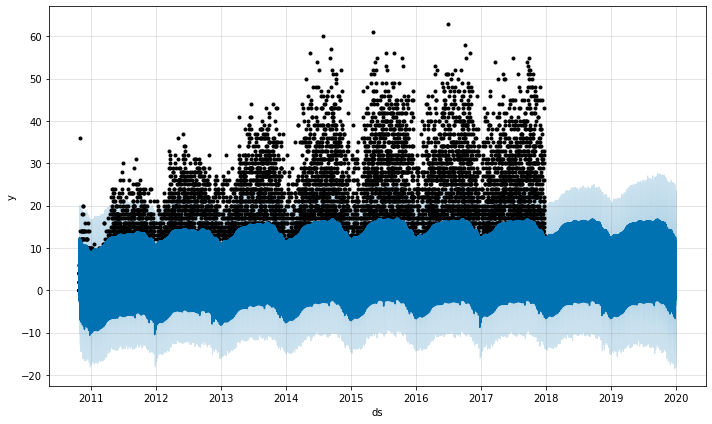

In [22]:
future = m.make_future_dataframe(periods=periods, freq='H')
fcast = m.predict(future)
fig = m.plot(fcast)

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\Admin\anaconda3\envs\forecasting_env\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



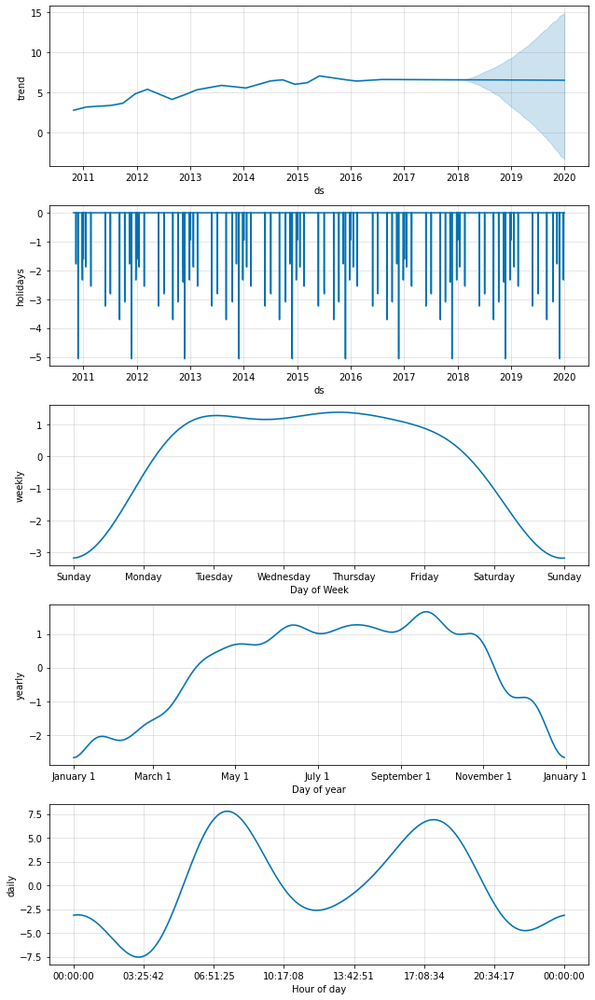

In [23]:
fig = m.plot_components(fcast)

In [24]:
future

,ds
0,2010-10-26 11:00:00
1,2010-10-26 12:00:00
2,2010-10-26 13:00:00
3,2010-10-26 14:00:00
4,2010-10-26 15:00:00
...,...
80479,2019-12-31 18:00:00
80480,2019-12-31 19:00:00
80481,2019-12-31 20:00:00
80482,2019-12-31 21:00:00


In [25]:
fcast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Christmas Day,Christmas Day_lower,Christmas Day_upper,Christmas Day (Observed),...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2010-10-26 11:00:00,2.757149,-4.052881,10.222593,2.757149,2.757149,0.0,0.0,0.0,0.0,...,1.202605,1.202605,1.202605,0.963872,0.963872,0.963872,0.0,0.0,0.0,2.966907
1,2010-10-26 12:00:00,2.757349,-5.238319,10.110804,2.757349,2.757349,0.0,0.0,0.0,0.0,...,1.193036,1.193036,1.193036,0.962855,0.962855,0.962855,0.0,0.0,0.0,2.306745
2,2010-10-26 13:00:00,2.757549,-4.352904,10.744001,2.757549,2.757549,0.0,0.0,0.0,0.0,...,1.184622,1.184622,1.184622,0.961826,0.961826,0.961826,0.0,0.0,0.0,3.062876
3,2010-10-26 14:00:00,2.757748,-3.325674,12.241416,2.757748,2.757748,0.0,0.0,0.0,0.0,...,1.177575,1.177575,1.177575,0.960785,0.960785,0.960785,0.0,0.0,0.0,4.618022
4,2010-10-26 15:00:00,2.757948,-0.736065,14.882508,2.757948,2.757948,0.0,0.0,0.0,0.0,...,1.172069,1.172069,1.172069,0.959732,0.959732,0.959732,0.0,0.0,0.0,6.767471
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80479,2019-12-31 18:00:00,6.505681,-0.569275,23.106840,-3.364061,14.877274,0.0,0.0,0.0,0.0,...,1.165913,1.165913,1.165913,-2.665256,-2.665256,-2.665256,0.0,0.0,0.0,11.704845
80480,2019-12-31 19:00:00,6.505678,-2.402455,20.810542,-3.365106,14.878136,0.0,0.0,0.0,0.0,...,1.167490,1.167490,1.167490,-2.665541,-2.665541,-2.665541,0.0,0.0,0.0,9.373259
80481,2019-12-31 20:00:00,6.505675,-7.247197,16.866351,-3.366150,14.878998,0.0,0.0,0.0,0.0,...,1.170874,1.170874,1.170874,-2.665809,-2.665809,-2.665809,0.0,0.0,0.0,5.343396
80482,2019-12-31 21:00:00,6.505671,-10.587271,13.314547,-3.367195,14.879860,0.0,0.0,0.0,0.0,...,1.176008,1.176008,1.176008,-2.666060,-2.666060,-2.666060,0.0,0.0,0.0,1.726178


In [26]:
fcast.columns

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'Christmas Day', 'Christmas Day_lower', 'Christmas Day_upper',
       'Christmas Day (Observed)', 'Christmas Day (Observed)_lower',
       'Christmas Day (Observed)_upper', 'Columbus Day', 'Columbus Day_lower',
       'Columbus Day_upper', 'Independence Day', 'Independence Day_lower',
       'Independence Day_upper', 'Independence Day (Observed)',
       'Independence Day (Observed)_lower',
       'Independence Day (Observed)_upper', 'Labor Day', 'Labor Day_lower',
       'Labor Day_upper', 'Martin Luther King Jr. Day',
       'Martin Luther King Jr. Day_lower', 'Martin Luther King Jr. Day_upper',
       'Memorial Day', 'Memorial Day_lower', 'Memorial Day_upper',
       'New Year's Day', 'New Year's Day_lower', 'New Year's Day_upper',
       'New Year's Day (Observed)', 'New Year's Day (Observed)_lower',
       'New Year's Day (Observed)_upper', 'Thanksgiving', 'Thanksgiving_lower',
       'Thanksgiv

In [28]:
fcast = fcast.set_index('ds')

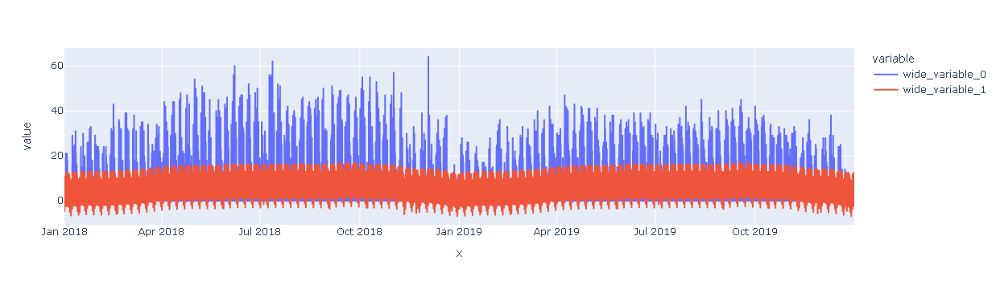

In [37]:
px.line(x=test_data['ds'], y=[test_data.y, fcast['2018':]['yhat']])

### Trying other models on the data
#### Weather data should be added before that and also the holidays of Washington DC

In [13]:
import holidays
from meteostat import Hourly, Stations

In [14]:
outgoings.index.year.unique().to_list()

[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

In [15]:
all_holidays = holidays.country_holidays('US', subdiv='DC', years=outgoings.index.year.unique().to_list())

In [16]:
import datetime

#### combining weather data and holidays

In [17]:
def get_holiday(row):
    # '2014-01-01'
    date = str(row.Start_date.year) + '-' + str(row.Start_date.month).zfill(2) + '-' + str(row.Start_date.day).zfill(2)
    row['holiday_name'] = all_holidays.get(date, 'No-Holiday')
    return row

outgoings = outgoings.reset_index().apply(get_holiday, axis=1)

In [18]:
stations = Stations()
stations = stations.nearby(outgoings.loc[0, 'start_lat'], outgoings.loc[0, 'start_lon'])
station = stations.fetch(1)

# Print DataFrame
station

,name,country,region,wmo,icao,latitude,longitude,elevation,timezone,hourly_start,hourly_end,daily_start,daily_end,monthly_start,monthly_end,distance
id,,,,,,,,,,,,,,,,
72405,Washington National Airport,US,DC,72405,KDCA,38.85,-77.0333,5.0,America/New_York,1936-09-01,2022-05-13,1936-09-01,2022-05-08,1936-01-01,2022-01-01,5771.14025


In [19]:
# Get hourly data
start = datetime.datetime(2010, 1, 1)
end_date = datetime.datetime(2020, 12, 31, 23, 59)
weather_data = Hourly('72405', start, end_date)
weather_data = weather_data.fetch()

In [20]:
weather_data.head(2)

,temp,dwpt,rhum,prcp,snow,wdir,wspd,wpgt,pres,tsun,coco
time,,,,,,,,,,,
2010-01-01 00:00:00,2.2,-0.1,85.0,NaN,NaN,240.0,9.4,NaN,1018.7,NaN,NaN
2010-01-01 01:00:00,2.2,-0.1,85.0,0.8,NaN,NaN,0.0,NaN,1018.2,NaN,NaN


In [21]:
outgoings = outgoings.drop(['start_lat', 'start_lon', 'end_lat', 'end_lon'], axis=1).set_index('Start_date', drop=True)

In [22]:
outgoings.head(2)

,rentals_in_hour,holiday_name
Start_date,,
2010-10-26 11:00:00,2,No-Holiday
2010-10-26 12:00:00,0,No-Holiday


In [23]:
weather_cols = {
    'dwpt': 'dew_point', 'rhum': 'rel_humidity', 'prcp': 'precipitation',
    'tsun': 'sun_minutes'
}
weather_data.rename(columns=weather_cols, inplace=True)
weather_data = weather_data.drop(['pres', 'coco'], axis=1)

In [24]:
weather_data.tail(2)

,temp,dew_point,rel_humidity,precipitation,snow,wdir,wspd,wpgt,sun_minutes
time,,,,,,,,,
2019-12-31 22:00:00,11.1,-1.0,43.0,0.0,NaN,220.0,16.6,NaN,NaN
2019-12-31 23:00:00,10.6,-1.2,44.0,0.0,NaN,220.0,11.2,NaN,NaN


In [25]:
weather_data.fillna(method='ffill', inplace=True)

In [26]:
outgoings.fillna(method='bfill', inplace=True)

In [27]:
outgoings = outgoings.merge(weather_data, how='left', left_index=True, right_index=True)

In [28]:
# outgoings = pd.get_dummies(outgoings.holiday_name, drop_first=True)
# outgoings = pd.get_dummies(outgoings, columns=['holiday_name'], drop_first=True)
outgoings['is_holiday'] = np.where(outgoings.holiday_name == 'No-Holiday', 0, 1)

In [29]:
outgoings.columns

Index(['rentals_in_hour', 'holiday_name', 'temp', 'dew_point', 'rel_humidity',
       'precipitation', 'snow', 'wdir', 'wspd', 'wpgt', 'sun_minutes',
       'is_holiday'],
      dtype='object')

### Checking for relation with the weather variables

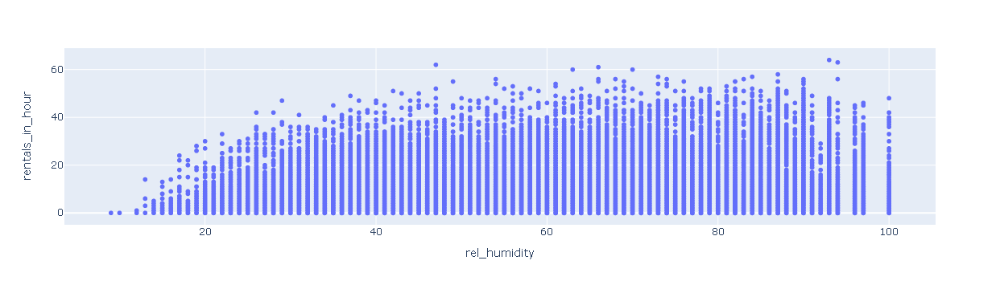

In [30]:
# 'dwpt': 'dew_point', 'rhum': 'rel_humidity', 'prcp': 'precipitation',
# 'tsun': 'sun_minutes'
# outgoings.rename(columns=weather_cols, inplace=True)
px.scatter(outgoings, x='rel_humidity', y='rentals_in_hour')

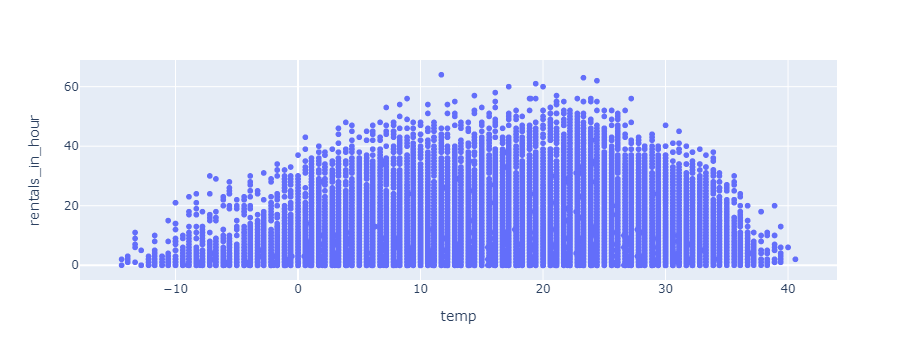

In [31]:
px.scatter(outgoings, x='temp', y='rentals_in_hour')

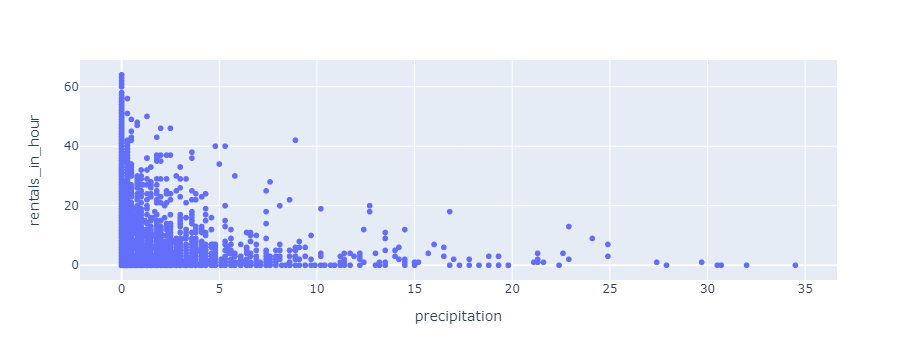

In [32]:
px.scatter(outgoings, x='precipitation', y='rentals_in_hour')

### Further feature engineering

In [33]:
# get the coulmn for weekend
outgoings.index.weekday.unique().to_list()
outgoings['work_day'] = np.where(outgoings.index.weekday.isin([0, 1, 2, 3, 4]), 1, 0)

In [34]:
months_order = outgoings.groupby(outgoings.index.month, as_index=True)[['rentals_in_hour']].sum().sort_values(
    by='rentals_in_hour', ascending=False
).index
months_order

Int64Index([8, 6, 7, 9, 10, 5, 4, 11, 3, 12, 2, 1], dtype='int64')

In [35]:
month_ranks = {}
for rank, month in enumerate(months_order):
    month_ranks[month] = rank + 1
    
month_ranks

{8: 1, 6: 2, 7: 3, 9: 4, 10: 5, 5: 6, 4: 7, 11: 8, 3: 9, 12: 10, 2: 11, 1: 12}

In [36]:
outgoings['month_rank'] = outgoings.index.month.map(month_ranks)

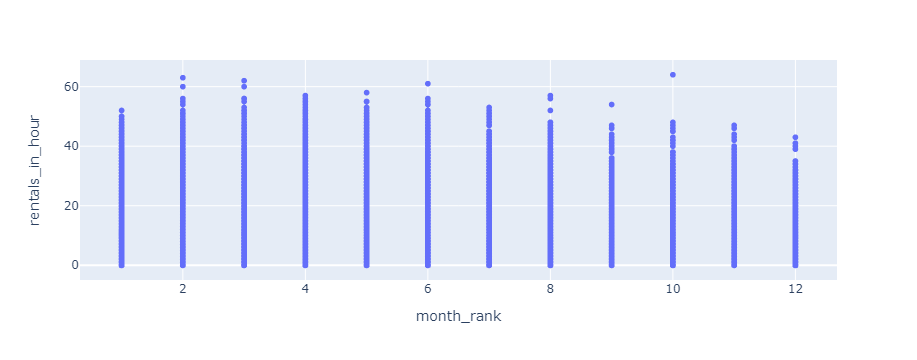

In [37]:
px.scatter(outgoings, x='month_rank', y='rentals_in_hour')

In [38]:
# adding hour of day rank as feature
hours_order = outgoings.groupby(outgoings.index.hour, as_index=True)[['rentals_in_hour']].sum().sort_values(
    by='rentals_in_hour', ascending=False
).index
hour_ranks = {}
for rank, hour in enumerate(hours_order):
    hour_ranks[hour] = rank + 1
    
print(hour_ranks)

{8: 1, 17: 2, 7: 3, 18: 4, 16: 5, 6: 6, 9: 7, 19: 8, 15: 9, 12: 10, 13: 11, 14: 12, 20: 13, 11: 14, 10: 15, 21: 16, 22: 17, 23: 18, 5: 19, 0: 20, 1: 21, 2: 22, 3: 23, 4: 24}


In [39]:
outgoings['hour_rank'] = outgoings.index.hour.map(hour_ranks)

In [40]:
# adding year too
outgoings['year'] = outgoings.index.year

In [41]:
outgoings.head(2)

,rentals_in_hour,holiday_name,temp,dew_point,rel_humidity,precipitation,snow,wdir,wspd,wpgt,sun_minutes,is_holiday,work_day,month_rank,hour_rank,year
2010-10-26 11:00:00,2,No-Holiday,18.0,16.0,88.0,0.0,NaN,180.0,11.2,NaN,NaN,0,1,5,14,2010
2010-10-26 12:00:00,0,No-Holiday,17.8,16.1,90.0,0.0,NaN,180.0,11.2,NaN,NaN,0,1,5,10,2010


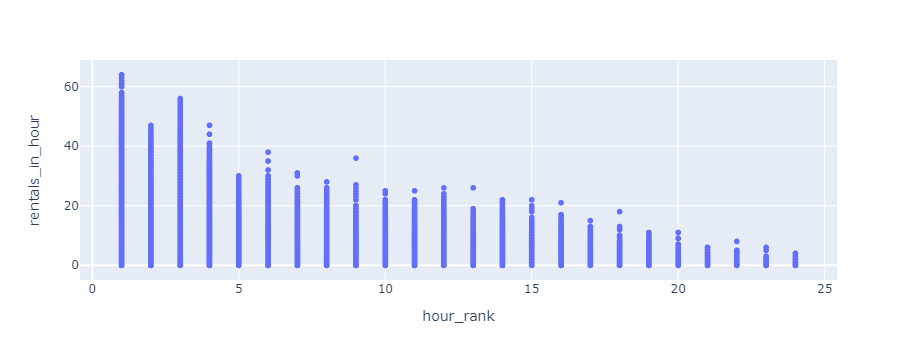

In [42]:
px.scatter(outgoings, x='hour_rank', y='rentals_in_hour')

In [43]:
outgoings.fillna(method='bfill', inplace=True)

### Testing different models

In [44]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.neural_network import MLPRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LinearRegression

In [45]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

In [46]:
outgoings.fillna(0, inplace=True)

In [47]:
# splitting in train and test set
X, y = outgoings.drop(['rentals_in_hour', 'holiday_name', 'dew_point'], axis=1), outgoings['rentals_in_hour']
X_train, X_test = X[:'2017'], X['2018':]
y_train, y_test = y[:'2017'], y['2018':]

In [48]:
lin_reg_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('mlp_regressor', LinearRegression())
    ]
)
lin_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp_regressor', LinearRegression())])

In [49]:
preds = lin_reg_pipe.predict(X_test)
mean_squared_error(y_true=y_test, y_pred=preds)

41.620992452240564

In [50]:
mlp_reg_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('mlp_regressor', MLPRegressor(random_state=1, max_iter=500))
    ]
)
mlp_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp_regressor', MLPRegressor(max_iter=500, random_state=1))])

In [51]:
mlp_preds = mlp_reg_pipe.predict(X_test)
# mlp_reg_pipe.score(X_test, y_test)

In [52]:
# y_test['mlp_preds'] = preds
mean_squared_error(y_true=y_test, y_pred=mlp_preds)

19.12172065357749

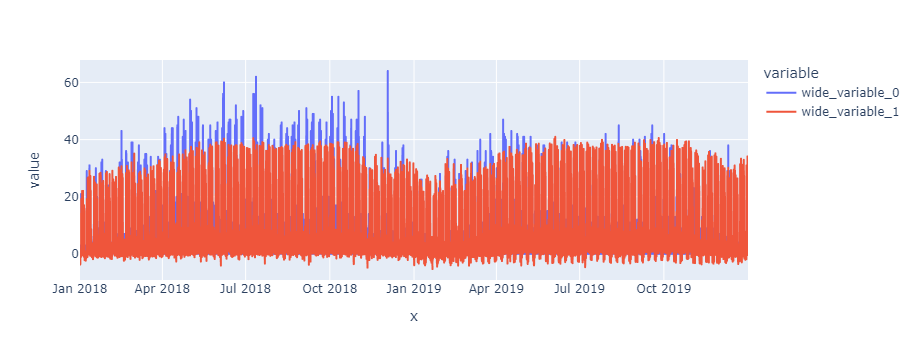

In [53]:
px.line(x=y_test.index, y=[y_test, mlp_preds])

In [54]:
ridge_reg_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('ridge_regression', Ridge(alpha=0.5))
    ]
)
ridge_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('ridge_regression', Ridge(alpha=0.5))])

In [55]:
ridge_preds = ridge_reg_pipe.predict(X_test)
mean_squared_error(y_true=y_test, y_pred=ridge_preds)

41.620946306861384

In [89]:
px.line(x=y_test.index, y=[y_test, ridge_preds])

NameError: name 'ridge_preds' is not defined

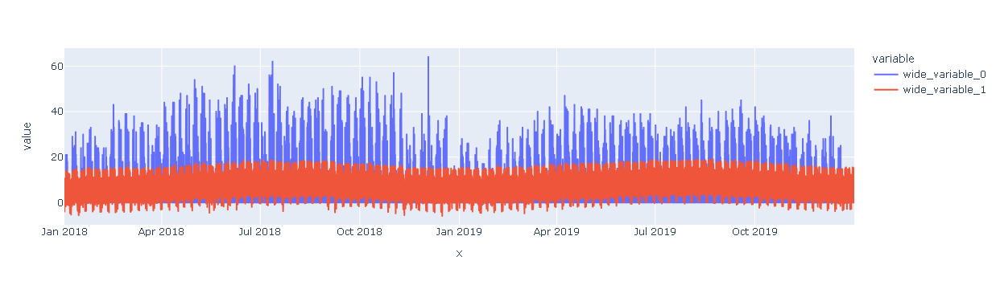

In [57]:
px.line(x=y_test.index, y=[y_test, ridge_preds])

In [58]:
from sklearn.ensemble import HistGradientBoostingRegressor

In [59]:
print(dir())

['HistGradientBoostingRegressor', 'Hourly', 'In', 'KernelRidge', 'LinearRegression', 'MLPRegressor', 'Out', 'Pipeline', 'Ridge', 'StandardScaler', 'Stations', 'X', 'X_test', 'X_train', '_', '_14', '_18', '_2', '_20', '_22', '_24', '_29', '_30', '_31', '_32', '_34', '_35', '_37', '_41', '_42', '_48', '_49', '_5', '_50', '_52', '_53', '_54', '_55', '_56', '_57', '_7', '_9', '__', '___', '__builtin__', '__builtins__', '__doc__', '__loader__', '__name__', '__package__', '__spec__', '_dh', '_i', '_i1', '_i10', '_i11', '_i12', '_i13', '_i14', '_i15', '_i16', '_i17', '_i18', '_i19', '_i2', '_i20', '_i21', '_i22', '_i23', '_i24', '_i25', '_i26', '_i27', '_i28', '_i29', '_i3', '_i30', '_i31', '_i32', '_i33', '_i34', '_i35', '_i36', '_i37', '_i38', '_i39', '_i4', '_i40', '_i41', '_i42', '_i43', '_i44', '_i45', '_i46', '_i47', '_i48', '_i49', '_i5', '_i50', '_i51', '_i52', '_i53', '_i54', '_i55', '_i56', '_i57', '_i58', '_i59', '_i6', '_i7', '_i8', '_i9', '_ih', '_ii', '_iii', '_oh', 'all_holiday

In [61]:
del Hourly
del KernelRidge
del LinearRegression
del Ridge
del Stations
del all_holidays
del datetime
del end_date
del start
del holidays
del hour
del hour_ranks
del hours_order
del preds
del rank
del ridge_preds
del ridge_reg_pipe
del union_station
del weather_cols
del weather_data
del lin_reg_pipe

In [62]:
gbr_pipe = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('hist_gbr', HistGradientBoostingRegressor(learning_rate=0.3, max_iter=300, l2_regularization=0.3,
                                                  random_state=42))
    ]
)
gbr_pipe.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('hist_gbr',
                 HistGradientBoostingRegressor(l2_regularization=0.3,
                                               learning_rate=0.3, max_iter=300,
                                               random_state=42))])

In [67]:
gbr_preds = gbr_pipe.predict(X_test)

In [68]:
mean_squared_error(y_true=y_test, y_pred=gbr_preds)

16.844585330977704

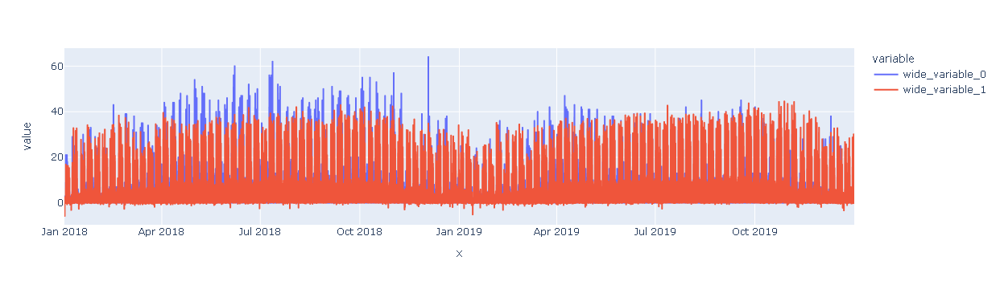

In [69]:
px.line(x=y_test.index, y=[y_test, gbr_preds])

In [86]:
mlp_reg_pipe_2 = Pipeline(
    [
        ('scaler', StandardScaler()),
        ('mlp_regressor', MLPRegressor(random_state=1, max_iter=700, alpha=0.00001,
                                      early_stopping=False))
    ]
)
mlp_reg_pipe_2.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('mlp_regressor',
                 MLPRegressor(alpha=1e-05, max_iter=700, random_state=1))])

In [87]:
mlp_2_preds = mlp_reg_pipe_2.predict(X_test)

In [88]:
mean_squared_error(y_true=y_test, y_pred=mlp_2_preds)

17.99789080370528

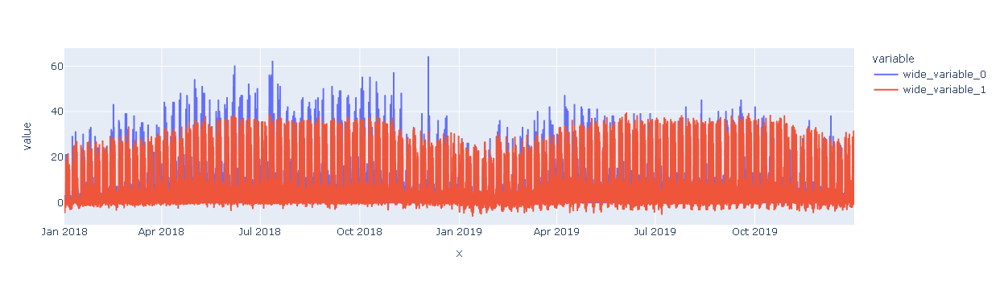

In [90]:
px.line(x=y_test.index, y=[y_test, mlp_2_preds])